# An Introduction to PySTAC for Remote Sensing
## Mikael Brunila<br>Geographic Information Centre (McGill)
### February 2025

# Overview

- **Part 1: Introduction** (15 min)
  - Issues with remote sensing (RS) data
  - What is STAC?
  - What is PySTAC?
- **Part 2: Code demo** (30 min)
  - Finding buildings in the Palisades Fire area in LA using Sentinel-2 data
- **Part 3: Hands-on** (45 min+)
  - Finding *burned* buildings in the Palisades Fire area in LA using Sentinel-2 data

## First...

Let's make sure all of you have the relevant notebook and files. You have two options:

1. Google Colab
2. Clone from Github

## Google Colab

Make sure you have the relevant files on your instance. These should include:

 - A folder called "data"
 - A folder called "img"
 - A .py file called "utiles.py"
 - A .py file called spectral_indexes.py

If you do *not* have them:

1. Download them from https://www.mediafire.com/file/656ulooyxizybxc/pystac_files.zip/file
2. Upload them to the Google Colab

# Part 1: Introduction

## Remote Sensing

Remote sensing is the process of detecting and collecting information of the physical characteristics of or on the Earth without making contact with the area.

There are today more than 10,000  (as of July 2024) satellites orbiting the Earth. They gather data at various resolutions (including very fine).

Most of these satellites are private, a significant amount owned or operated by StarLink.

- At least 1,052 “earth observations”

## Remote Sensing Data

Remote sensing data is often stored in very large image files of high-resolution formats like `.tif`.

Storing and processing this data in very unwieldy. This is where tools and platforms like STAC, Google Earth Engine (GEE), and Microsoft Planetary Computer (MPC) come in. They provide data standards (STAC) or cloud computing resources (GEE, MPC).

# STAC: Spatio-Temporal Asset Catalog

A "common language to describe geospatial information". No processing capabilities, not a cloud service like GEE or MPC (which uses STAC). STAC is all about standardizing metadata for geospatial data, enabling better data discovery and interoperability.

Provides standards for storing, indexing, and accessing geospatial data in general and satellite RS data in particular. We can "postpone" the actual processing until the very last step by relying on interconnected metadata instead.

JSON-files that are organized in a hierarchy:

- Item (images for bands in a given area, e.g. a Sentinel-2 scene from a specific bbox)
- Collection (sets of images from a given source, e.g. Sentinel-2 and LandSat)
- Catalog (a list of data sources)

# STAC: Item

A STAC Item represents ***one* captured image**, e.g., a Sentinel-2 scene over New York on 2024-06-15.

<img src="/content/img/STAC-Item.jpeg" alt="Drawing" style="width: 75%;"/>

*Source: [The STAC Specification](https://stacspec.org/en/tutorials/intro-to-stac/)*<br>

# STAC: Item

If this was your STAC item, you could choose "assets" within this bbox, including and RGB image or specific "bands" (red, blue, green, but also near infrared, short-wave infrared, etc.).

<img src="content/img/geojson-example.png" alt="Drawing" style="width: 75%;"/>

*Source: [The STAC Specification](https://stacspec.org/en/tutorials/intro-to-stac/)* <br>

## STAC: Collection

A STAC Collection groups multiple images from the same source (e.g. Sentinel-2 ) together. It defines shared metadata like temporal coverage and data sources.

<img src="content/img/STAC-Collection.png" alt="Drawing" style="width: 75%;"/>

*Source: [The STAC Specification](https://stacspec.org/en/tutorials/intro-to-stac/)* <br>

## STAC: Catalog

A STAC Catalog is a higher-level structure that links different collections (e.g., Sentinel-2, Landsat, NAIP).

<img src="content/img/STAC-Catalog.jpeg" alt="Drawing" style="width: 50%;"/>

*Source: [The STAC Specification](https://stacspec.org/en/tutorials/intro-to-stac/)* <br>

## STAC: Catalog

A STAC catalog has its own specification in something like `catalog.json`. In addition to collections, it can include individual items.

<img src="content/img/Catalog-layout.jpeg" alt="Drawing" style="width: 50%;"/>

*Source: [The STAC Specification](https://stacspec.org/en/tutorials/intro-to-stac/)* <br>

## STAC: Programming Languages and Frameworks

- Python: [pystac](https://github.com/stac-utils/pystac)
- JavaScript: [stac-server](https://github.com/stac-utils/stac-server)
- Rust: [stac-rs](https://github.com/stac-utils/stac-rs)
- R: [rstac](https://github.com/brazil-data-cube/rstac)
- QGIS: [qgis-stac-plugin](https://github.com/stac-utils/qgis-stac-plugin)

## PySTAC

The most actively maintained and comprehensive framework for accessing STAC assets. Provides tools for searching, filtering, and accessing dozens of STAC catalogs.

Additionally, offers in-memory manipulations of STAC catalogs:  Load and work with STAC catalog data as Python objects entirely within your computer's memory. Data loaded like this is by default in the `xarray` format, but we will often convert it to `numpy` for the sake of simplicity.

An overview of catalogs can be found [here](https://stacindex.org/catalogs/). Today we will be using [Earth Search](https://stacindex.org/catalogs/earth-search#/) by Amazon owned Element84.

# Part 2: Code Demo

# Part 2A: Preamble

## The LA 2025 Fires

- From January 7th to 31st
- Killed 28+ people (wite 31+ more still missing) and forced 200,000+ to evacuate
- Destroyed 18,189+ buildings
- Concentrated in the Altadena and Pacific Palisades neighborhoods

## Our Case Study: The Palisades Fire

- Pacific Palisades
- Killed 12 people (with 7 more still missing) and forced 105,000 to evacuate
- Destroyed 6,837 buildings, damaged 1,017

## Our Case Study: The Palisades Fire

- Researchers at CUNY and Oregon State University used data from the Sentinel-1 and Sentinel-2 satellites to assess the damage
- We will try to replicate part of the study by using Sentinel-2 data

<img src="content/img/Corey_Scher_LA_Wildfires_Map_2560px.jpg" alt="Drawing" style="width: 75%;"/>

*Source: [How and Why a CUNY Graduate Center Student Maps the Devastation of Wildfires and War](https://www.gc.cuny.edu/news/how-and-why-cuny-graduate-center-student-maps-devastation-wildfires-and-war)* <br>

At the end, we will have replicated this map to produce a very close estimate using only *spectral indexes*:

<img src="content/img/burned_structures_highres.png" alt="Drawing" style="width: 75%;"/>


## Spectral Indexes

Spectral indexes are mathematical formulas used in remote sensing to highlight specific surface features in satellite images. By comparing different wavelengths of reflected light, these indexes help identify patterns such as vegetation growth, water presence, urban areas, or burned regions.

**For instance:** The Normalized Difference Vegetation Index (NDVI) measures vegetation health by comparing NIR and Red reflectance. **Higher** values indicate healthy vegetation, while **lower** values suggest bare soil, water, or built-up areas.

$NDVI = \frac{\text{NIR} - \text{Red}}{\text{NIR} + \text{Red}}$


## Spectral Indexes for Analysing Structural Fire Damage

For our analysis, we want to:

1. Preprocess by removing big bodies of water such as the ocean
2. Identify buildings
3. Identify areas that were burned *after* the fire
4. Find the overlap between buildings and burned areas

## Removing water: NDWI

The Normalized Difference Water Index (NDWI) highlights water bodies by comparing Green and NIR reflectance. **Higher** values indicate water, while **lower** values represent vegetation or soil.

$NDWI = \frac{\text{Green} - \text{NIR}}{\text{Green} + \text{NIR}}$

## Identifying buildings: NDBI and IBI

The Normalized Difference Built-up Index (NDBI) is used to identify and distinguish built-up areas like cities and urban environments. **Higher** positive values indicate more built-up areas:

$NDBI = \frac{\text{SWIR}_1 - \text{NIR}}{\text{SWIR}_1 + \text{NIR}}$

IBI improves upon NDBI by combining multiple spectral signals, offering a more nuanced and accurate depiction of built-up areas, especially in mixed landscapes. **Higher** IBI als indicate more built-up areas:

$IBI = \frac{\text{NDBI} - (\text{NDVI} + \text{NDWI})}{\text{NDBI} + (\text{NDVI} + \text{NDWI})}$

Today, we will use IBI.

## Identifying burns: NBR and dNBR

NBR is used to detect burned areas and assess fire severity by comparing Near-Infrared (NIR) and Shortwave Infrared (SWIR-2) reflectance. Healthy vegetation has high NIR reflectance and low SWIR-2 reflectance, while burned areas show the opposite pattern. **Higher** NBR values indicate healthy vegetation, while **lower** values indicate burned or barren land.

$NBR = \frac{\text{NIR} - \text{SWIR}_2}{\text{NIR} + \text{SWIR}_2}$

By comparing the pre-fire and post-fire NBR, we can get a sense of what areas were ravaged by the fire:

$\mathrm{dNBR} = \mathrm{NBR}_{\text{pre}} - \mathrm{NBR}_{\text{post}}$

Designed for vegetation, so not ideal. But we will see it works quite well! This is why the CUNY study uses SAR data from Sentinel-1 instead. However, SAR is a lot more complicated so not suitable for quick-and-dirty workshop :)

### Workflow

In order to estimate and visualize these indexes for the Palisades, we will go through the following workflow.

**Accessing catalogues**
- pystac_client

**Browsing and filtering**
- pystac
- shapely

**Loading and processing data**
- odc-stac
- xarray
- numpy

**Visualizing data**
- ipyleaflet
- geopandas
- matplotlib

# Part 2B: Coding

## Install and load libraries

In [ ]:
# !pip install folium==0.19.4 geopandas==1.0.1 ipyleaflet==0.19.2 matplotlib==3.10.0 numpy==2.2.3 odc_geo==0.4.8 odc_stac==0.3.11 pystac==1.12.0 pystac_client==0.8.3 Shapely==2.0.7 tqdm==4.66.5 xarray==2024.7.0

In [ ]:
import folium
import geopandas as gpd
import ipyleaflet
import matplotlib.pyplot as plt
import pystac_client
import shapely

from IPython.display import Image
from odc.stac import stac_load
from shapely import Polygon
from shapely.geometry import box
from tqdm import tqdm

%load_ext autoreload
%autoreload 2

## Load helper functions

In [ ]:
from utils import *

## Access and browse the catalog

- PyStac allows us to directly access some of these resources as they are stored by actors such as AWS, Google, and Microsoft.
- We will use data as provided by the AWS affiliated company Element84.
- There are a few other providers that give access to the same data.

In [ ]:
sentinel_client = pystac_client.Client.open("https://earth-search.aws.element84.com/v1")
sentinel_client

<Client id=earth-search-aws>

Once we've established the connection to Element84, we can check what data and from which satellites do we have access to.

In [ ]:
collections = list(sentinel_client.get_collections())
n_collections = len(collections)

In [ ]:
print(f"There are {n_collections} collections:\n")
for c in collections:
    print(c.id)

There are 9 collections:

sentinel-2-pre-c1-l2a
cop-dem-glo-30
naip
cop-dem-glo-90
landsat-c2-l2
sentinel-2-l2a
sentinel-2-l1c
sentinel-2-c1-l2a
sentinel-1-grd


There are three different satellites

1. Data from the Sentinel missions of the Copernicus program: ```sentinel-2-pre-c1-l2a```, ```sentinel-2-l2a```, ```sentinel-2-l1c```, ```sentinel-2-c1-l2a```, ```sentinel-1-grd```
2. Data from the TanDEM-X mission of the Copernicus program: ```cop-dem-glo-30``` \& ```cop-dem-glo-90```
3. Data from the [National Agriculture Imagery Program (NAIP)](https://naip-usdaonline.hub.arcgis.com/): ```naip```
4. Data from the [Landsat program](https://www.usgs.gov/landsat-missions/landsat-collection-2-level-2-science-products): ```landsat-c2-l2```

## Sentinel-2

We will use the [sentinel-2-l2a dataset](https://docs.sentinel-hub.com/api/latest/data/sentinel-2-l2a/). This dataset has a few advantegous properties. It is:

1. Available at a good resolution. 10 m, 20 m, and 60 m depending on wavelength
2. Uses a MultiSpectral Instrument (MSI) with 13 bands: 4 visible bands, 6 Near-Infrared bands, 3 Short-Wave Infrared bands
3. Available at a frequent interval: Collected every 5 days
4. Available at ```"l2a"```, i.e. atmospherically corrected surfance reflectance

![](content/img/sentinel_2_revisit_freq.png)
*Source: https://sentiwiki.copernicus.eu/web/s2-mission*

Moreover:
- It is available at land and coastal areas between latitudes 56°S and 83°N
- Global data available since January 2017, some local patches since October 2016

In [ ]:
collection = "sentinel-2-l2a"

## Explore the available data

This data is available almost "real time". We can, for instance, easily get data for January and February in February of the year this was written (2025).

In [ ]:
date = "2025-02-01/2025-02-25"

Before accessing the satellite data, we have to choose a specific area of interest (AOI). We can use the package ```ipyleaflet``` to visualize a point in the Wet'suwet'en territory.

In [ ]:
height = 600
width = 1200

In [ ]:
m = ipyleaflet.Map()
m.center = 34.05, -118.55
m.zoom = 14
m.layout.height = str(height) + "px"
m.layout.width = str(width) + "px"
m

Map(center=[34.05, -118.55], controls=(ZoomControl(options=['position', 'zoom_in_text', 'zoom_in_title', 'zoom…

![](/content/img/bbox.png)

This preview can *directly* be used to get the "bounding box" (bbox) of our AOI.

In [ ]:
bbox=[m.west, m.south, m.east, m.north]

Now, using this bbox and our dates of interest, we can retrieve information *about* the images that are available for that AOI at that time.

We run our query with three filters we want images with

1. less than 20% of their pixels missing.
2. less than 20% degraded spectral data.
3. less than 20% cloud cover.

Additionally, we recommend the service return only 5 images.

In [ ]:
query = ["s2:nodata_pixel_percentage<20",
         "s2:degraded_msi_data_percentage<20",
         "eo:cloud_cover<20"]

In [ ]:
%%time
item_search_t1 = sentinel_client.search(collections=[collection], # Filter by collection
                                 datetime=date, # Filter by date
                                 bbox=bbox, # Filter by area
                                 query=query, # Filter by quality
                                 limit=5) # Limit n returned images to 5

CPU times: user 1.18 ms, sys: 22 µs, total: 1.21 ms
Wall time: 1.21 ms


What we get in return is a PyStac ```ItemSearch```. This is like getting the search results of Google. You haven't yet loaded the data of the websites returned by your search, only some data *about* each website.

Similarly, we now have data *about* the relevant items, not yet the items nor their assets.

Why? Because these assets are HUGE images! You could easily end up downloading tens of gigabytes by accident.

In [ ]:
item_search_t1.item_collection()

In [ ]:
item_collection_t1 = item_search_t1.item_collection()

In [ ]:
n_items_t1 = len(item_collection_t1)
n_items_t1

2

Before downloading the actual images, we can use the `geopandas`, `shapely`, and `folium` packages the size and various properties of our images of interest.

Here, we look at the water percentage of each image. It's an arbitrary attribute, but it shows how the images correspond to the underlying map.

In [ ]:
#!pip install mapclassify==2.8.1

In [ ]:
gdf = gpd.GeoDataFrame.from_features(
    item_collection_t1.to_dict(),
    crs="EPSG:4326"
)
bbox_geom = shapely.geometry.mapping(shapely.geometry.box(*bbox))
bbox_layer = folium.GeoJson(bbox_geom)

m = gdf.explore(column="eo:cloud_cover")
bbox_layer.add_to(m)
m

The search itself is a generator object that includes metadata for all the items returned for the query.

In [ ]:
item_search_t1.items()

<generator object ItemSearch.items at 0x7b3b7aac87c0>

In [ ]:
list(item_search_t1.items())

[<Item id=S2C_11SLT_20250221_0_L2A>, <Item id=S2C_11SLT_20250201_0_L2A>]

Using a custom function, we can print some attributes of each image.

In [ ]:
print_item_search_attributes(item_search_t1)

2 items found:

ID: S2C_11SLT_20250221_0_L2A 
 Cloud cover (%): 4.984134 
 Missing pixels (%): 0 
 Missing band data (%): 0.0213 
 Image area (km^2): 1.17 

ID: S2C_11SLT_20250201_0_L2A 
 Cloud cover (%): 15.756986 
 Missing pixels (%): 0 
 Missing band data (%): 0.0213 
 Image area (km^2): 1.17 



## Time 1: Working with one item

Before working with the whole set of items, let's take a look at just one image. We'll pick the one with the least cloud cover. This is our "$t_1$", data from the current moment or "time one".

In [ ]:
items_t1 = list(item_collection_t1)

In [ ]:
min_cloud_t1 = get_item_with_min_attribute(items_t1, attr='eo:cloud_cover')
min_cloud_t1.properties['datetime']

'2025-02-21T18:45:25.463000Z'

Before loading the item, we can access a low resolution "thumbnail" image to preview it.

In [ ]:
Image(url=min_cloud_t1.assets["thumbnail"].href, width=400)

The image is very low res, but it gives us a sense of what's to come. Notice that it's a lot bigger than our area of interest.

### Item Assets ($t_1$)

Each item comes with several "assets", which broadly speaking are images at different wavelengths and resolutions.

In [ ]:
print_assets(min_cloud_t1)

aot | Aerosol optical thickness (AOT)
blue | Blue - 10m
cloud | Cloud Probabilities
coastal | Coastal - 60m
granule_metadata | None
green | Green - 10m
nir | NIR 1 - 10m
nir08 | NIR 2 - 20m
nir09 | NIR 3 - 60m
product_metadata | None
red | Red - 10m
rededge1 | Red Edge 1 - 20m
rededge2 | Red Edge 2 - 20m
rededge3 | Red Edge 3 - 20m
scl | Scene classification map (SCL)
snow | Snow Probabilities
swir16 | SWIR 1.6μm - 20m
swir22 | SWIR 2.2μm - 20m
tileinfo_metadata | None
visual | True color image
wvp | Water Vapour (WVP)
thumbnail | Thumbnail of preview image
aot-jp2 | Aerosol optical thickness (AOT)
blue-jp2 | Blue - 10m
coastal-jp2 | Coastal - 60m
green-jp2 | Green - 10m
nir-jp2 | NIR 1 - 10m
nir08-jp2 | NIR 2 - 20m
nir09-jp2 | NIR 3 - 60m
red-jp2 | Red - 10m
rededge1-jp2 | Red Edge 1 - 20m
rededge2-jp2 | Red Edge 2 - 20m
rededge3-jp2 | Red Edge 3 - 20m
scl-jp2 | Scene classification map (SCL)
swir16-jp2 | SWIR 1.6μm - 20m
swir22-jp2 | SWIR 2.2μm - 20m
visual-jp2 | True color image
wvp

### Selecting Assets and Area ($t_1$)

Recall, that we are interested in four different indexes (NDVI, NDWI, IBI, NBR) as well as RGB imagery. To compile these, we select the following bands:

- RGB (red, green, blue), i.e. "standard" photography
- Two bands of short-wave infrared (SWIR16, SWIR22) and near infrared (NIR)

We can select them from the Sentinel-2 data with the following query words:

In [ ]:
selected_bands = ["swir16", "swir22","nir","red","green","blue"]

All of these are available at either the 10m or 20m resolution!

## Getting the appropriate polygon ($t_1$)

We are still only dealing with descriptions of our data, *not* the actual data.

Before we load the data, recall that the images of interestet were MUCH larger than our area of interest. So we want to filter and only load part of each image.

To do this, we find the intersection polygons between (1) each image of interest and (2) the total area of interest.

For our example image, the bounds of the image can be found like this, using the Python package `shapely`:

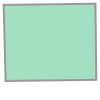

In [ ]:
min_cloud_t1_poly = Polygon(*min_cloud_t1.geometry['coordinates'])
min_cloud_t1_poly

For the bbox of our total AOI, like this:

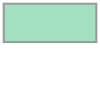

In [ ]:
bbox_poly = box(*bbox)
bbox_poly

Now, we can use `shapely` to find their intersection.

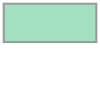

In [ ]:
intersection_poly = shapely.intersection(
    bbox_poly,
    min_cloud_t1_poly)

intersection_poly

For our example image, *this* is the part of the image that we want to retrieve!

In [ ]:
min_cloud_t1.geometry

{'type': 'Polygon',
 'coordinates': [[[-119.17376896599782, 34.32235671057083],
   [-119.14885662021419, 33.33277630652224],
   [-117.96938626406873, 33.34758667242361],
   [-117.98063319821665, 34.33772750342932],
   [-119.17376896599782, 34.32235671057083]]]}

In [ ]:
min_cloud_t1

<Item id=S2C_11SLT_20250221_0_L2A>

## Load the Item into Memory ($t_1$)

To reiterate.

To actually get the data and not just a description of it, we need to "load" it.

- We only pick the relevant bands
- We limit the image to the intersection polygon
- We lower the resolution

Now we can actually retrieve our example image using the `stac_load` function from the helper library `odc.stac`. This returns an `xarray` dataset.

In [ ]:
data_t1 = stac_load([min_cloud_t1],
                    bands = selected_bands,
                    bbox=intersection_poly.bounds,
                    crs="EPSG:32611",
                    chunks={},
                    #resolution=0.5, #could be as low as 0.00009009
                    progress=tqdm).isel(time=0)

data_t1

<xarray.Dataset> Size: 6MB
Dimensions:      (y: 489, x: 959)
Coordinates:
  * y            (y) float64 4kB 3.771e+06 3.771e+06 ... 3.766e+06 3.766e+06
  * x            (x) float64 8kB 3.521e+05 3.522e+05 ... 3.617e+05 3.617e+05
    spatial_ref  int32 4B 32611
    time         datetime64[ns] 8B 2025-02-21T18:45:25.463000
Data variables:
    swir16       (y, x) uint16 938kB dask.array<chunksize=(489, 959), meta=np.ndarray>
    swir22       (y, x) uint16 938kB dask.array<chunksize=(489, 959), meta=np.ndarray>
    nir          (y, x) uint16 938kB dask.array<chunksize=(489, 959), meta=np.ndarray>
    red          (y, x) uint16 938kB dask.array<chunksize=(489, 959), meta=np.ndarray>
    green        (y, x) uint16 938kB dask.array<chunksize=(489, 959), meta=np.ndarray>
    blue         (y, x) uint16 938kB dask.array<chunksize=(489, 959), meta=np.ndarray>

## RGB visualization ($t_1$)

Normally, RGB data is expressed on the 0 to 255 or 0 to 1 range. That's no the case with Sentinel-2 data, so we normalize it into the 0, 255 range.

In [ ]:
normalized_rgb_t1 = normalize_to_rgb(data_t1)
normalized_rgb_t1.shape

(489, 959, 3)

Now we can get a regular RGB image of the intersection polygon we are interested in.

Text(0.5, 1.0, 'The Pacific Palisades in LA after the January 2025 Fires')

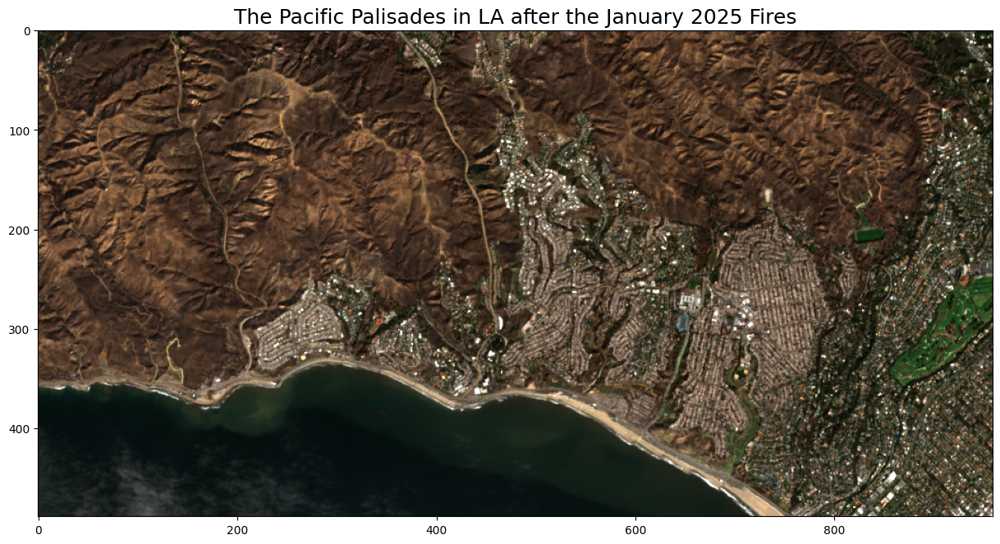

In [ ]:
fig, ax = plt.subplots(figsize=(15, 15))

cax = ax.imshow(normalized_rgb_t1)
ax.set_title("The Pacific Palisades in LA after the January 2025 Fires", size=18)

We can see that the hills are burned brown, in stark contrast to the green landscape in the lower-right corner.

## Calculating Spectral Indices ($t_1$)

While we an see the burned area because we *know* it's there, we could use spectral indexes to discover it. For instance, recall that the formula for NDVI is:

$NDVI = \frac{(nir - red)}{(nir + red)}$

In code, this can be written as

In [ ]:
def return_ndvi(data:xr.Dataset) -> xr.DataArray:
    """
    Calculate and return NDVI.
    """

    # Turn red band into floats
    red = data["red"].astype("float")

    # Turn near infrared band into floats
    nir = data["nir"].astype("float")

    # Calculate NDVI
    ndvi = (nir - red) / (nir + red)
    return ndvi

In [ ]:
# Compute NDVI (Normalized Difference Vegetation Index)
ndvi_t1 = return_ndvi(data_t1)

I have written helper functions to calculate the two other indexes we need today.

In [ ]:
from spectral_indexes import *

ndwi_t1 = return_ndwi(data_t1)
ibi_t1 = return_ibi(data_t1)

## Visualizing Spectral Indices ($t_1$)

Using ```matplotlib```, we can plot the NDVI values for T1 like so. What's that huge white blob? It's water. Let's remove it.

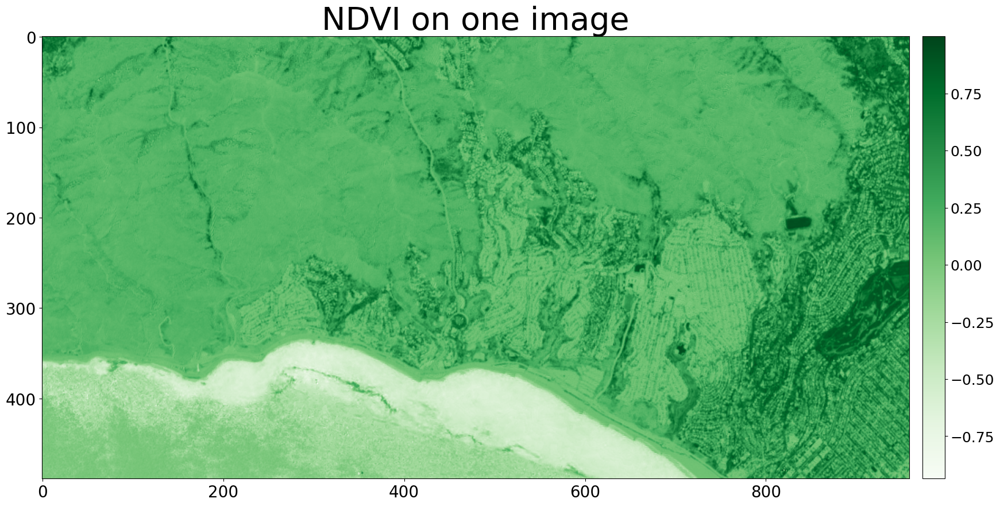

In [ ]:
plot_single_image_spectral_idx(ndvi_t1, 30, 10, name = "NDVI")

NDWI helps us here.

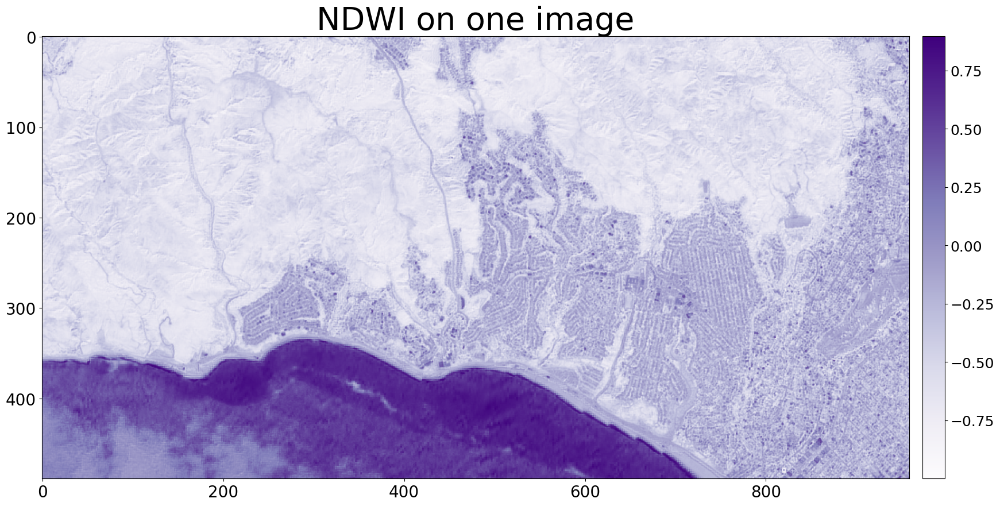

In [ ]:
plot_single_image_spectral_idx(ndwi_t1, 30, 10, name = "NDWI", cmap="Purples")

Using the NDWI, we can filter the water away from our building and vegetation indexes.

In [ ]:
water_mask_t1 = ndwi_t1 > 0.1

ndvi_water_masked = np.where(water_mask_t1, np.nan, ndvi_t1)
ibi_water_masked = np.where(water_mask_t1, np.nan, ibi_t1)

Now, we get the following NDVI image. What do you notice?

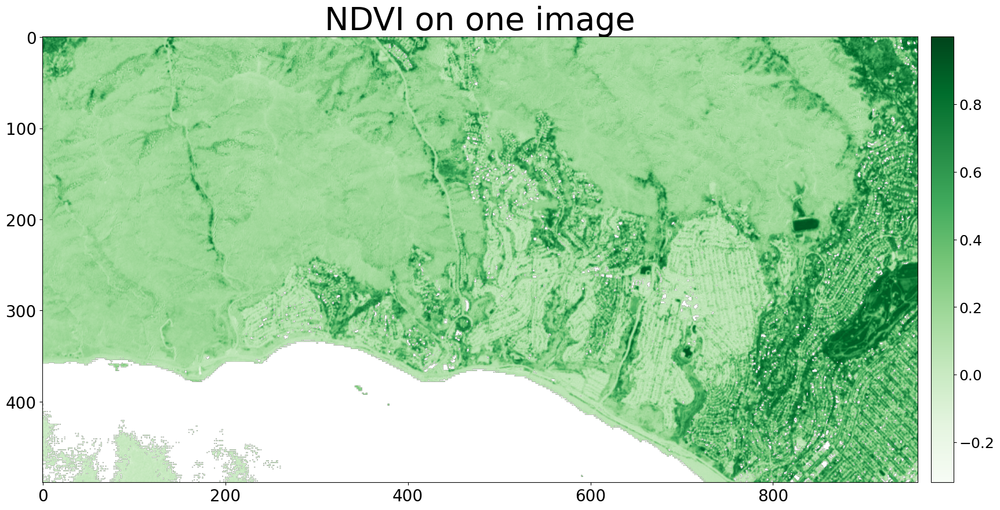

In [ ]:
plot_single_image_spectral_idx(ndvi_water_masked, 30, 10, name = "NDVI")

To find the buildings, we can plot the IBI after water masking. Notice how the Palisades have a much lower IBI than the neighboring area.

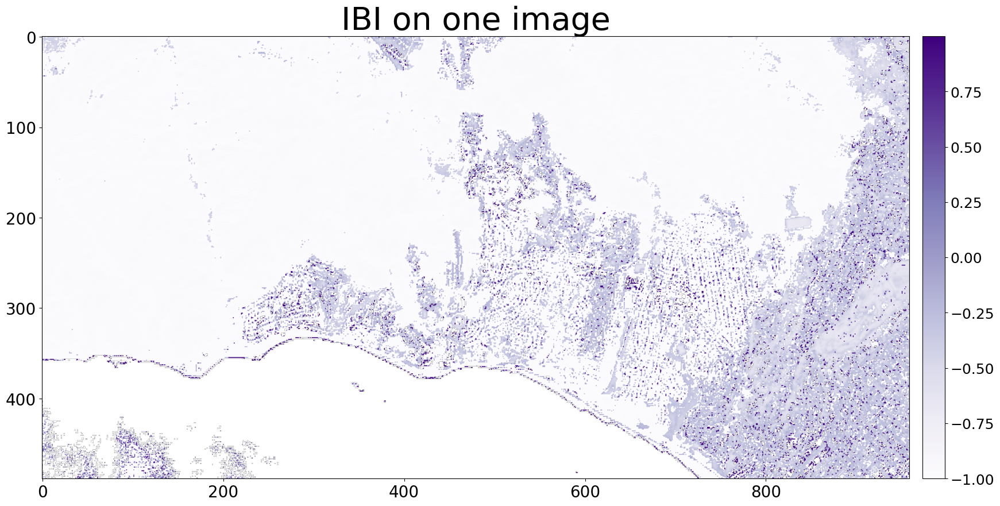

In [ ]:
plot_single_image_spectral_idx(ibi_water_masked, 30, 10, name = "IBI", cmap="Purples")

## Spectral index median values ($t_1$)

While we have explored the use of one image, it's better praxis to average values over several images. Here, we are interested in the month that has passed since the fire, i.e. all the $t_1$ items.

In [ ]:
item_list_t1 = list(item_collection_t1)
item_list_t1

[<Item id=S2C_11SLT_20250221_0_L2A>, <Item id=S2C_11SLT_20250201_0_L2A>]

We can calculate the NDVI and IBI for all of these. Let's also calculate the NBR to see the burned areas. First, we loop over all the items and calculate each index...

In [ ]:
ndvis_t1 = calculate_spectral_index_over_items(item_list_t1, selected_bands, bbox, return_ndvi)
ibis_t1 = calculate_spectral_index_over_items(item_list_t1, selected_bands, bbox, return_ibi)
nbrs_t1 = calculate_spectral_index_over_items(item_list_t1, selected_bands, bbox, return_nbr)

Processing item 1 out of 2


100%|██████████| 6/6 [00:01<00:00,  4.70it/s]


Processing item 2 out of 2


100%|██████████| 6/6 [00:04<00:00,  1.29it/s]


Processing item 1 out of 2


100%|██████████| 6/6 [00:00<00:00,  7.66it/s]


Processing item 2 out of 2


100%|██████████| 6/6 [00:01<00:00,  4.30it/s]


Processing item 1 out of 2


100%|██████████| 6/6 [00:00<00:00,  6.35it/s]


Processing item 2 out of 2


100%|██████████| 6/6 [00:01<00:00,  5.50it/s]


... then we calculate the median.

In [ ]:
%time median_ndvi_t1 = calculate_median_index(ndvis_t1)
%time median_ibi_t1 = calculate_median_index(ibis_t1)
%time median_nbr_t1 = calculate_median_index(nbrs_t1)

Concatenating Spectral Index images.
Calculating the means, this will take a while.
CPU times: user 14.9 ms, sys: 1.99 ms, total: 16.9 ms
Wall time: 16.6 ms
Concatenating Spectral Index images.
Calculating the means, this will take a while.
CPU times: user 13.7 ms, sys: 0 ns, total: 13.7 ms
Wall time: 13.7 ms
Concatenating Spectral Index images.
Calculating the means, this will take a while.
CPU times: user 12.4 ms, sys: 0 ns, total: 12.4 ms
Wall time: 12.4 ms


Behind the scenes, we have been using `xarray`. However, at this point we transition into `numpy`. We can use a very simple dummy function for this. However, we need to flip the data using `np.flipud()` in order to get it right in `numpy`.

In [ ]:
def xr_spectral_index_data_to_np(xr_data:xr.DataArray) -> np.ndarray:
    """
    Turn xr.DataArray to np.ndarray and flip the results to make map face south to north.
    """
    return np.flipud(xr_data.to_numpy())

In [ ]:
median_ndvi_t1_np = xr_spectral_index_data_to_np(median_ndvi_t1)
median_ibi_t1_np = xr_spectral_index_data_to_np(median_ibi_t1)
median_nbr_t1_np = xr_spectral_index_data_to_np(median_nbr_t1)

## Plot Spectral Medians ($t_1$)

Let's plot the result, starting with the median NDVI.

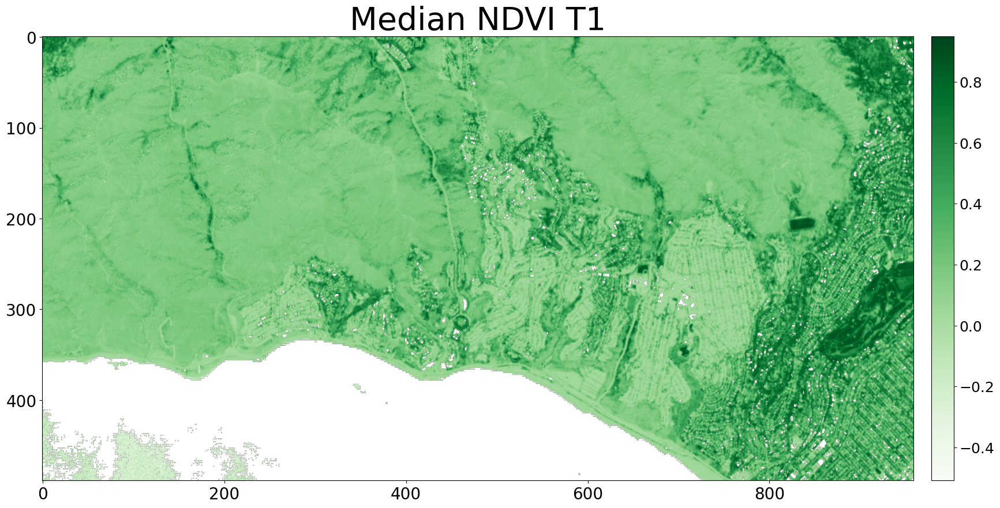

In [ ]:
median_ndvi_t1_np_water_masked = np.where(np.flipud(water_mask_t1), np.nan, median_ndvi_t1_np)
plot_territory(median_ndvi_t1_np_water_masked, 30, 10, 'Greens', 'Median NDVI T1')

Next, the IBI.

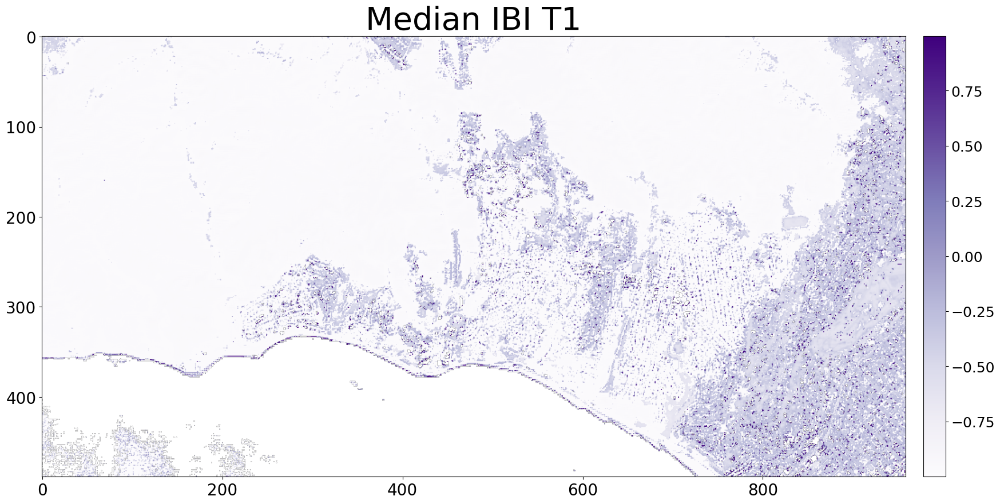

In [ ]:
median_ibi_t1_np_water_masked = np.where(np.flipud(water_mask_t1), np.nan, median_ibi_t1_np)
plot_territory(median_ibi_t1_np_water_masked, 30, 10, 'Purples', 'Median IBI T1')

Finally, we get to the NBR. Notice how stark the contrast is between the affected areas and the neighboring area that was spared from the fire.

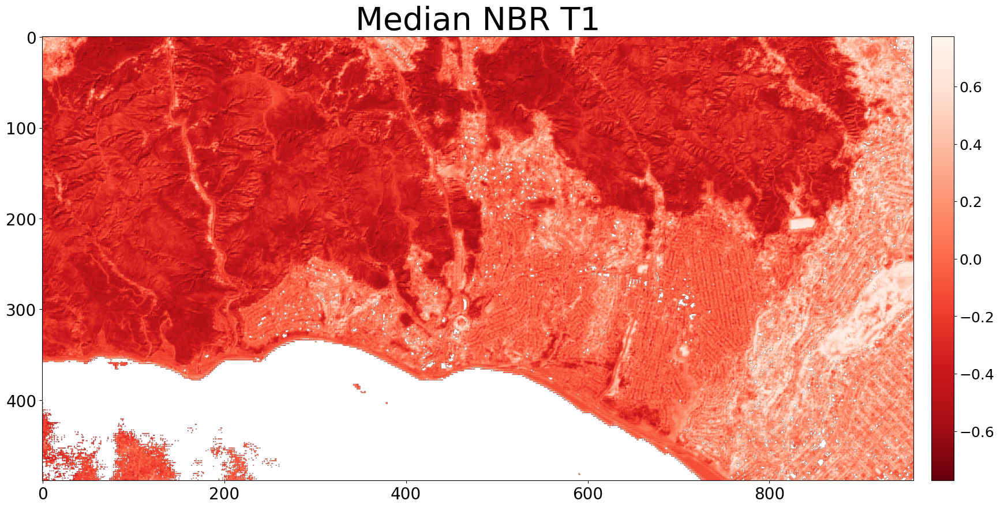

In [ ]:
median_nbr_t1_np_water_masked = np.where(np.flipud(water_mask_t1), np.nan, median_nbr_t1_np)
plot_territory(median_nbr_t1_np_water_masked, 30, 10, 'Reds_r', 'Median NBR T1')

# Part 2: Hands-on

## Spectral Index change detection ($t_1$ - $t_0$)

Having calculated our indexes for $t_1$, we now have a starting point for seeing the impact of the Palisades Fire. For this purpose, we will re-calculate the indexes, but this time for a $t_0$ prior to the fire. Then, we will subtract these $t_0$ values from our $t_1$ values.

### Choosing your $t_0$

In [ ]:
dates_t0 = "2024-12-01/2025-01-06"

**Prompt:** How would you search for data from this period?

In [ ]:
%%time
# item_search_t0 = <YOUR_CODE_HERE>

CPU times: user 832 µs, sys: 0 ns, total: 832 µs
Wall time: 842 µs


In [ ]:
print_item_search_attributes(item_search_t0)

2 items found:

ID: S2A_11SLT_20250102_0_L2A 
 Cloud cover (%): 3.015763 
 Missing pixels (%): 7e-06 
 Missing band data (%): 0 
 Image area (km^2): 1.17 

ID: S2B_11SLT_20241218_0_L2A 
 Cloud cover (%): 0.004997 
 Missing pixels (%): 0 
 Missing band data (%): 0.0213 
 Image area (km^2): 1.17 



### Detour: Fixing Item Properties ($t_0$)

Before we dive deeper into the data, we need to take a brief detour. While preparing this tutorial, I noticed that newer Sentinel-2 data threw an error with older versions  of `pystac` while older Sentinel-2 data caused trouble with newer versions of `pystac`. The following code blocks resolve these issues. In brief, the standards for storing projection data seem to have changed.

In [ ]:
def print_item_properties(item, string:str="proj"):
    for key, value in item.properties.items():
        if string in key:
            print(f"{key}:{value}")

def fix_item_proj_properties(source, target, string:str="proj"):
    for key, value in source.properties.items():
        if string in key:
            target.properties[key] = value
    return target

Old way.

In [ ]:
print_item_properties(items_t0[0])

proj:epsg:32611


New way.

In [ ]:
print_item_properties(min_cloud_t1)

proj:code:EPSG:32611
proj:centroid:{'lat': 33.83606, 'lon': -118.56814}


Loop over old items and add projection metadata from newer item.

In [ ]:
items_t0 = [fix_item_proj_properties(min_cloud_t1, item, "proj") for item in list(items_t0)]
items_t0

[<Item id=S2A_11SLT_20250102_0_L2A>, <Item id=S2B_11SLT_20241218_0_L2A>]

## Load Item ($t_0$)

Okay, back to business.

**Prompt:** Filter your $t_0$ items for the one with minimum cloud cover. Then, load your data using `stac_load`.

In [ ]:
# min_cloud_t0 = <YOUR_CODE_HERE>

In [ ]:
# data_t0 = <YOUR_CODE_HERE>
# data_t0

<xarray.Dataset> Size: 6MB
Dimensions:      (y: 489, x: 959)
Coordinates:
  * y            (y) float64 4kB 3.771e+06 3.771e+06 ... 3.766e+06 3.766e+06
  * x            (x) float64 8kB 3.521e+05 3.522e+05 ... 3.617e+05 3.617e+05
    spatial_ref  int32 4B 32611
    time         datetime64[ns] 8B 2024-12-18T18:45:03.766000
Data variables:
    swir16       (y, x) uint16 938kB dask.array<chunksize=(489, 959), meta=np.ndarray>
    swir22       (y, x) uint16 938kB dask.array<chunksize=(489, 959), meta=np.ndarray>
    nir          (y, x) uint16 938kB dask.array<chunksize=(489, 959), meta=np.ndarray>
    red          (y, x) uint16 938kB dask.array<chunksize=(489, 959), meta=np.ndarray>
    green        (y, x) uint16 938kB dask.array<chunksize=(489, 959), meta=np.ndarray>
    blue         (y, x) uint16 938kB dask.array<chunksize=(489, 959), meta=np.ndarray>

**Prompt:** Plot an RGB version of the image.

In [ ]:
normalized_rgb_t0 = <YOUR_CODE_HERE>

(489, 959, 3)

In [ ]:
#<YOUR_PLOT_CODE_HERE>

Text(0.5, 1.0, 'The Pacific Palisades in LA After the January 2025 Fires')

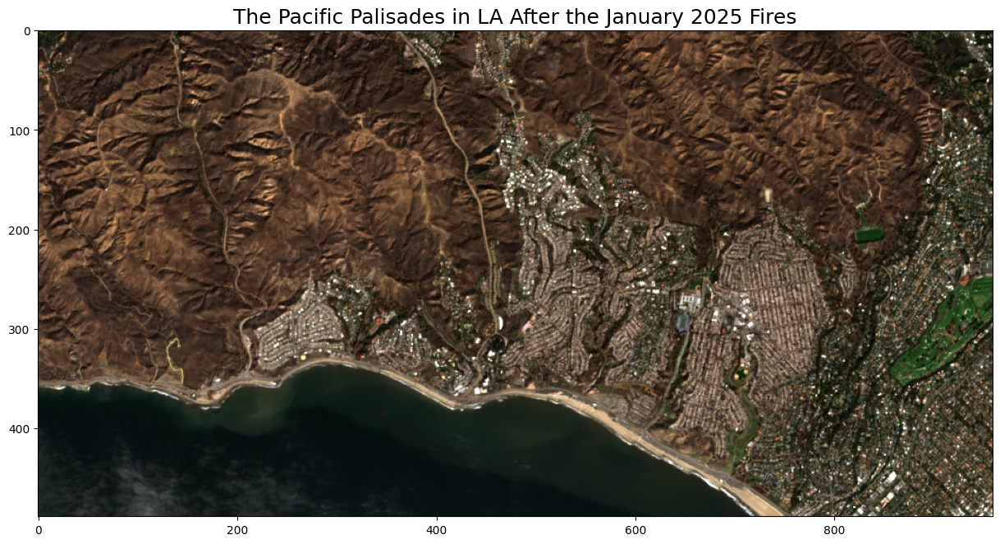

In [ ]:
fig, ax = plt.subplots(figsize=(15, 15))

cax = ax.imshow(normalized_rgb_t1)
ax.set_title("The Pacific Palisades in LA After the January 2025 Fires", size=18)

## Spectral indexes for $t_0$

**Prompt:** Now, calculate the NDVI, NDWI, IBI, and NBR for *all* items at $t_0$.

In [ ]:
# <YOUR_CODE_HERE>

**Prompt:** Calculate the median for each index.

In [ ]:
# <YOUR_CODE_HERE>

**Prompt:** Convert these medians from `xarray` to `numpy`.

In [ ]:
# <YOUR_CODE_HERE>

**Prompt:** Plot each of these medians. Remember to filter for water!

In [ ]:
# <YOUR_CODE_HERE>

In [ ]:
# <YOUR_CODE_HERE>

In [ ]:
# <YOUR_CODE_HERE>

## Building Filter

**Prompt:** We are mainly interested in damage for buildings. For that purpose:

1. Setup a building filter similar to water.
2. Mask that filter for water.
3. Then plot this "buildings but no water".

In [ ]:
# <YOUR_CODE_HERE>

In [ ]:
# <YOUR_CODE_HERE>

## Calculating the Spectral differences

Now we are approaching the grand finale! We want to calculate the differences between $t_1$ and $t_0$ values. I'll show how with NDVI.

In [ ]:
ndvi_difference = median_ndvi_t1 - median_ndvi_t0
ndvi_difference_np = xr_spectral_index_data_to_np(ndvi_difference)
ndvi_difference_np[ndvi_difference_np>0] = 0

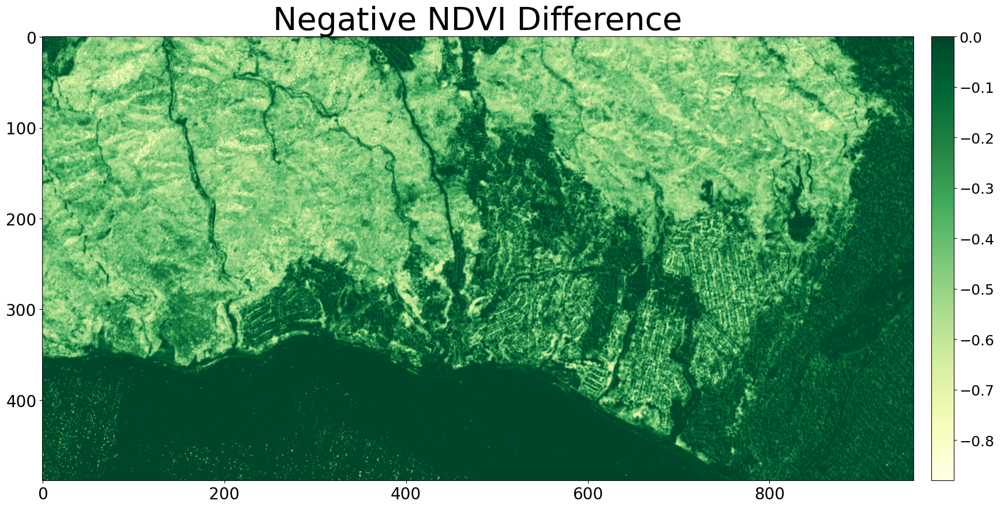

In [ ]:
plot_territory(ndvi_difference_np, 40, 10, 'YlGn', 'Negative NDVI Difference')

**Prompt:** Now do the same with the NBR.

In [ ]:
# <YOUR_CODE_HERE>

In [ ]:
# <YOUR_CODE_HERE>

Okay, the final "mask".

**Prompt:** Use *both* the NBR filter *and* our $t_0$ buildings to map buildings that sustained fire damage.

In [ ]:
# <YOUR_CODE_HERE>

In [ ]:
# <YOUR_CODE_HERE>

## Plotting it all

Now we can return to the image at the start.

**Prompt:** Use the code below to plot the outputs from your experiments above. `burned_buildings` should be an `array` with NBR values for building pixels and `nan` elsewhere. `normalized_rgb_t1` should be an `array` with RGB-values normalized to the 0, 1 range.

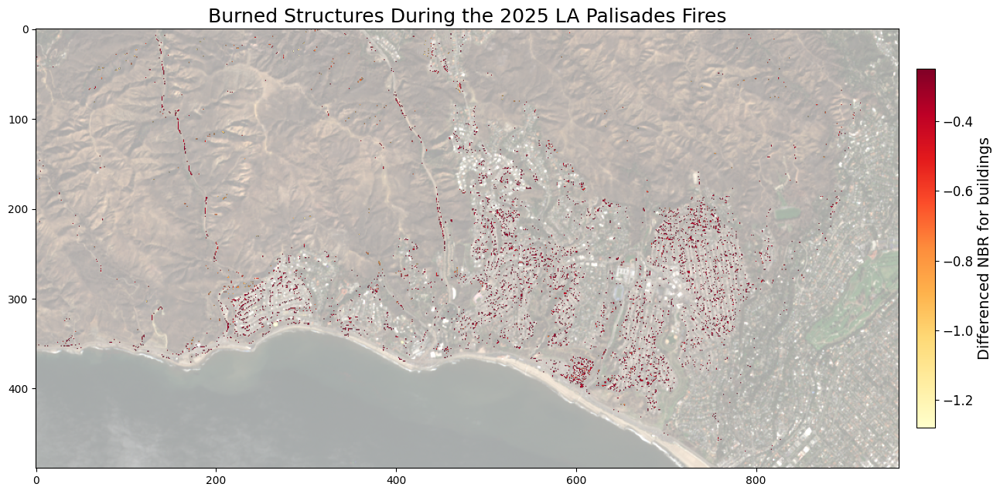

In [ ]:
# Create the figure and plot the base image
fig, ax = plt.subplots(figsize=(15, 15))
base = ax.imshow(normalized_rgb_t1, alpha=0.35)  # The background image
ax.set_title("Burned Structures During the 2025 LA Palisades Fires", size=18)

# Overlay the second dataset on top
overlay = plot_overlay(ax, burned_buildings, cmap="YlOrRd", alpha=1)

# Add a colorbar for the overlay
cbar = plt.colorbar(overlay, ax=ax, fraction=0.02, pad=0.02)
cbar.ax.tick_params(labelsize=12)
cbar.set_label("Differenced NBR for buildings", size=14)
fig.savefig("content/img/burned_structures_highres.png", dpi=300, bbox_inches="tight")

## Comparing with building footprints

How well did we do? We can compare with footprints of buildings provided by the LA county in order to evaluate.

<img src="content/img/la_building_footprints.png" alt="Drawing" style="width: 75%;"/>

*Source: [https://data.lacounty.gov/datasets/lacounty::2023-buildings-with-dins-data/explore](https://data.lacounty.gov/datasets/lacounty::2023-buildings-with-dins-data/explore)*

In [ ]:
la_buildings = gpd.read_file("data/2023_Buildings_with_DINS_data.geojson")
la_buildings.head(3)

,OBJECTID,CODE,BLD_ID,HEIGHT,ELEV,SOURCE,DATE_,STATUS,OLD_BLD_ID,AREA,DAMAGE,STRUCTURET,Shape__Area,Shape__Length,geometry
0,1,Building,405063833902,29.21,95.95,LARIAC2,2008,Unchanged,None,1062.196900,None,None,144.039062,57.653066,"POLYGON Z ((-118.51685 34.03063 0, -118.5168 3..."
1,2,Building,405077833794,16.68,54.91,LARIAC2,2008,Unchanged,None,1339.697198,None,None,181.675781,59.368595,"POLYGON Z ((-118.51679 34.03032 0, -118.51674 ..."
2,3,Building,404932833728,2.12,51.39,LARIAC2,2008,Unchanged,None,357.872695,None,None,48.527344,28.082028,"POLYGON Z ((-118.51735 34.03008 0, -118.5173 3..."


In [ ]:
# Classify damage into three categories.
def classify_damage(damage):
    if damage == 'No Damage' or damage is None:
        return 'Undamaged'
    elif damage == 'Inaccessible':
        return 'Inaccessible'
    else:
        return 'Damaged'

In [ ]:
# Add a new column for the classified damage category.
la_buildings["damage_category"] = la_buildings["DAMAGE"].apply(classify_damage)


**Prompt:** Replace `burned_buildings` in the code below with your `array` with damage to buildings. How did you do?

In [ ]:
from matplotlib.colors import ListedColormap
from shapely.geometry import box

def plot_buildings_and_raster(la_buildings, burned_buildings):

    raster_bounds = (-118.60153198242189,
                     34.028691046671696,
                     -118.49853515625001,
                     34.07136000446003)
    im_bounds = (-118.60153198242189,
                 -118.49853515625001,
                 34.028691046671696,
                 34.07136000446003)

    fig, ax = plt.subplots(figsize=(12, 8))


    # Color mapping for building damage.
    new_damage_colors = {
        'Damaged': 'yellow',      # red
        'Undamaged': '#2ca02c',    # green
        'Inaccessible': '#7f7f7f'  # gray
    }

    # Plot filled polygons for each damage category (no outline here).
    for category, group in la_buildings.groupby("damage_category"):
        group.plot(ax=ax,
                   facecolor=new_damage_colors.get(category, '#cccccc'),
                   edgecolor='none',
                   alpha=0.5,
                   label=category)

    # Overlay a separate outline for all buildings (outline added here).
    la_buildings.boundary.plot(ax=ax, color='black', linewidth=0.15)

    # Add a legend.
    ax.legend(title="Damage Category")

    # Plot the raster (burned_buildings) with its geographic bounds.
    cmap = ListedColormap(['white', 'red'])
    ax.imshow(np.flipud(burned_buildings), cmap=cmap, alpha=1,
              extent=im_bounds,
              interpolation='nearest',
              origin='upper')

    # Add title and axis labels.
    ax.set_title('Buildings and Burned Areas Overlay')
    ax.set_xlabel('Longitude')
    ax.set_ylabel('Latitude')

    # Turn off the grid.
    ax.grid(False)

    plt.tight_layout()
    plt.show()


<ipython-input-88-28676740ac75>:37: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend(title="Damage Category")
<ipython-input-88-28676740ac75>:37: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  ax.legend(title="Damage Category")


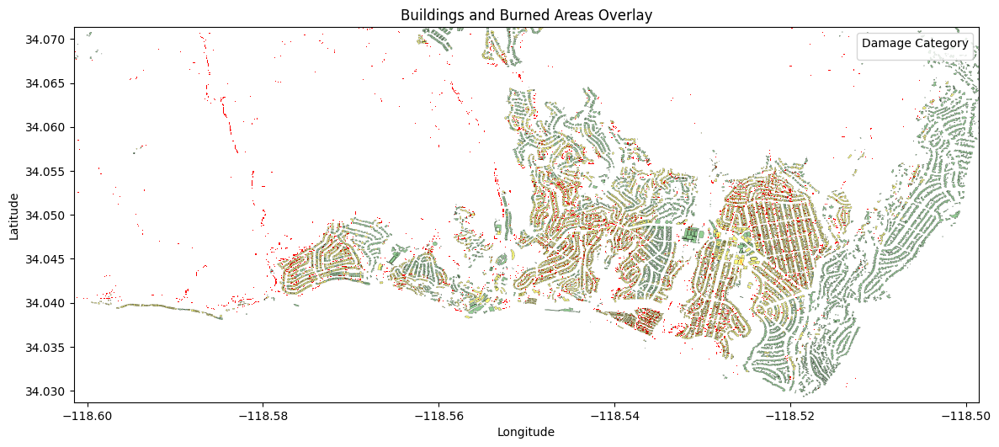

In [ ]:
# plot_buildings_and_raster(<YOUR_VARIABLES_HERE>)